In [1]:
import diffrax as dfx
import jax
import jax.numpy as jnp
import jax.random as jrand
import jax.random as jrandom
import matplotlib as mpl
import matplotlib.pyplot as plt

from felice.neuron_models import Boomerang

jax.config.update("jax_enable_x64", True)

In [2]:
key = jrand.key(0)
max_time = 20

model = Boomerang(
    rho=30,
    rtol=1e-2,
    atol=1e-3,
    dtype=jnp.float64,
)


def state_at_t(comp_times):
    sol = dfx.diffeqsolve(
        terms=dfx.ODETerm(model.dynamics),
        solver=dfx.Tsit5(),
        t0=0.0,
        t1=max_time,
        dt0=1e-3,
        y0=model.init_state(1)
        + jrandom.uniform(key, shape=(1, 2), minval=0.1, maxval=0.5),
        saveat=dfx.SaveAt(ts=comp_times),
        max_steps=100000,
    )

    return sol.ts, sol.ys

In [3]:
comp_times = jnp.linspace(0.0, max_time, 2000)
_, state = state_at_t(comp_times)

In [4]:
def compute_nullclines(snn, u_range, v_range, resolution=200):
    """
    Compute nullclines
    du/dt = 0 (u-nullcline)
    dv/dt = 0 (v-nullcline)
    """
    u_vals = jnp.linspace(u_range[0], u_range[1], resolution)
    v_vals = jnp.linspace(v_range[0], v_range[1], resolution)
    U, V = jnp.meshgrid(u_vals, v_vals)

    dU, dV = snn.vector_field(U, V)

    return U, V, dU, dV


def plot_vf(ax, snn, u_range, v_range):
    import numpy as np

    u_sparse = jnp.linspace(u_range[0], u_range[1], 40)
    v_sparse = jnp.linspace(v_range[0], v_range[1], 40)

    Us, Vs = jnp.meshgrid(u_sparse, v_sparse)

    U, V, dU, dV = compute_nullclines(snn, u_range, v_range, 200)

    dUs, dVs = snn.vector_field(Us, Vs)

    # Normalize for visualization
    magnitude = np.sqrt(dUs**2 + dVs**2)
    magnitude[magnitude == 0] = 1
    # dUs_norm = dUs / magnitude
    # dVs_norm = dVs / magnitude

    # Nullclines
    ax.contour(U, V, dU, levels=[0], colors="blue", linewidths=1, linestyles="-")
    ax.contour(U, V, dV, levels=[0], colors="red", linewidths=1, linestyles="-")

    # Vector field
    # ax.quiver(Us, Vs, dUs_norm, dVs_norm, magnitude, cmap="viridis", alpha=0.6)
    ax.streamplot(
        np.array(Us),
        np.array(Vs),
        np.array(dUs),
        np.array(dVs),
        cmap=plt.cm.inferno,
        color=magnitude,
        density=2.0,
        linewidth=0.5,
        arrowsize=0.5,
        arrowstyle="->",
    )

    ax.set_xlabel("u")
    ax.set_ylabel("v")
    ax.set_title("Boomerang: Phase Portrait")
    ax.legend(["u-nullcline (du/dt=0)", "v-nullcline (dv/dt=0)"], loc="upper right")
    ax.set_xlim(u_range)
    ax.set_ylim(v_range)
    ax.axhline(y=0, color="gray", linestyle="--", alpha=0.3)
    ax.axvline(x=0, color="gray", linestyle="--", alpha=0.3)

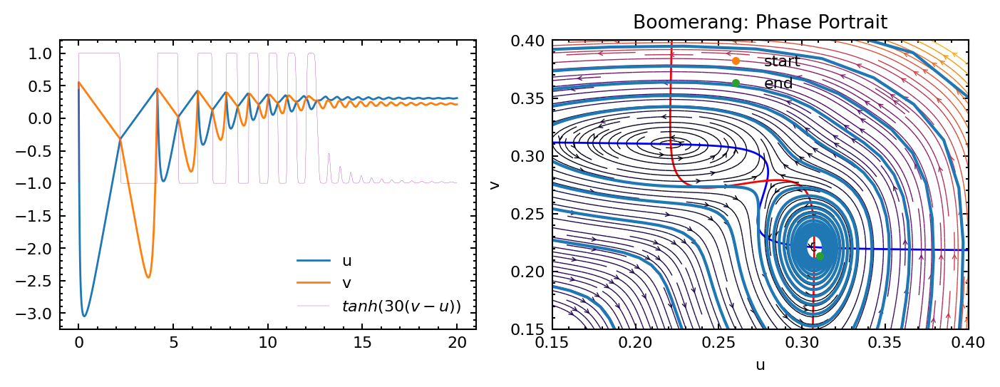

In [5]:
z = jax.nn.tanh(30 * (state[:, 0, 1] - state[:, 0, 0]))

with mpl.style.context("boilerplot.ieeetran"):
    fig, ax = plt.subplots(1, 2, figsize=(6.9, 2.6), dpi=200)
    ax[0].plot(comp_times, state[:, 0, 0], label="u")
    ax[0].plot(comp_times, state[:, 0, 1], label="v")
    ax[0].plot(comp_times, z, color="purple", linewidth=0.1, label="x2")

    ax[0].legend(["u", "v", "$tanh(30(v - u))$"])

    plot_vf(ax[1], model, [0.15, 0.4], [0.15, 0.4])
    ax[1].plot(state[:, 0, 0], state[:, 0, 1], "-", linewidth=1.5)
    ax[1].plot(state[0, 0, 0], state[0, 0, 1], ".", label="start")
    ax[1].plot(state[-1, 0, 0], state[-1, 0, 1], ".", label="end")
    ax[1].legend()
    plt.show()

In [6]:
from IPython.display import HTML
from matplotlib.animation import FuncAnimation
from tqdm.auto import tqdm

mpl.rcParams["animation.embed_limit"] = 2**128

# Animation parameters
n_frames = 100
frame_indices = jnp.linspace(0, len(comp_times) - 1, n_frames).astype(int)

pbar = tqdm(total=n_frames, desc="Generating animation")
with mpl.style.context("boilerplot.ieeetran"):
    fig, ax = plt.subplots(1, 2, figsize=(6.9, 2.6), dpi=150)

    # Initialize empty plots
    (line_u,) = ax[0].plot([], [], label="u")
    (line_v,) = ax[0].plot([], [], label="v")
    (line_z,) = ax[0].plot(
        [], [], color="purple", linewidth=0.1, label="$tanh(30(v - u))$"
    )

    (current_marker_time,) = ax[0].plot([], [], "ko", markersize=5)

    ax[0].legend(["u", "v", "$tanh(30(v - u))$"])
    ax[0].set_xlim(comp_times[0], comp_times[-1])
    ax[0].set_ylim(jnp.min(state) - 0.01, jnp.max(state) + 0.01)
    ax[0].set_xlabel("Time")
    ax[0].set_ylabel("State")

    # Phase portrait setup
    plot_vf(ax[1], model, [0.15, 0.4], [0.15, 0.4])
    (trajectory_line,) = ax[1].plot([], [], "-", linewidth=1.5, color="C0")
    (start_marker,) = ax[1].plot(
        [state[0, 0, 0]], [state[1, 0, 0]], "o", label="start", markersize=6
    )
    (current_marker,) = ax[1].plot([], [], "ko", markersize=8, label="current")
    ax[1].legend()

    def init():
        line_u.set_data([], [])
        line_v.set_data([], [])
        line_z.set_data([], [])
        trajectory_line.set_data([], [])
        current_marker.set_data([], [])
        current_marker_time.set_data([], [])
        return (
            line_u,
            line_v,
            line_z,
            trajectory_line,
            current_marker,
            current_marker_time,
        )

    def animate(frame):
        idx = frame_indices[frame]

        # Update time series
        line_u.set_data(comp_times[:idx], state[:idx, 0, 0])
        line_v.set_data(comp_times[:idx], state[:idx, 0, 1])
        line_z.set_data(comp_times[:idx], z[:idx])
        current_marker_time.set_data([comp_times[idx]], [state[idx, 0, 0]])

        # Update phase portrait
        trajectory_line.set_data(state[:idx, 0, 0], state[:idx, 0, 1])
        current_marker.set_data([state[idx, 0, 0]], [state[idx, 0, 1]])

        # Update progress bar
        pbar.update(1)

        return (
            line_u,
            line_v,
            line_z,
            trajectory_line,
            current_marker,
            current_marker_time,
        )

    anim = FuncAnimation(
        fig,
        animate,
        init_func=init,
        frames=n_frames,
        interval=100,
        blit=True,
        repeat=True,
    )

    plt.close()  # Prevent static display

html_anim = anim.to_jshtml()
pbar.close()
HTML(html_anim)

Generating animation:   0%|          | 0/100 [00:00<?, ?it/s]

In [7]:
save_pbar = tqdm(total=n_frames, desc="Saving animation")


def progress_callback(current_frame, total_frames):
    """Callback function to update progress bar during save"""
    save_pbar.update(1)


anim.save("boomerang.mp4", writer="ffmpeg", fps=10, progress_callback=progress_callback)
save_pbar.close()

Saving animation:   0%|          | 0/100 [00:00<?, ?it/s]